<a href="https://colab.research.google.com/github/albivaltzew/urbancode_samolet/blob/main/urbancode_postprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

source https://docs.ultralytics.com/guides/sahi-tiled-inference/#benefits-of-sliced-inference

# sahi simple implementation

In [1]:
!pip install -U ultralytics sahi


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 618.0/618.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.0/104.0 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.3/88.3 kB 12.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fire: filename=fire-0.5.0-py2.py3-none-any.whl size=116934 sha256=1d5451b69b5904c41e15718a99c7ab5a7f1f96ac720e9ef6ff5fb665073f6cf4
  Stored in directory: /root/.cache/pip/wheels/90/d4/f7/9404e5db0116bd4d43e5666eaa3e70ab53723e1e3ea40c9a95
Successfully built fire


In [ ]:
import sahi.utils.yolov8

In [ ]:
# from sahi.utils.yolov8 import download_yolov8m_model
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from pathlib import Path
from IPython.display import Image

# Download YOLOv8 model
yolov8_model_path = "/content/drive/MyDrive/urbancode/urbanhack-train/best283.pt"
# download_yolov8m_model(yolov8_model_path)


In [ ]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_model_path,
    confidence_threshold=0.3,
    device="cpu",  # or 'cuda:0'
)


In [ ]:
img_path = "/content/novostroyki-dlya-ipoteki-pod-2-nachali-stroit-v-novyh-regionah-rf-foto-1.jpeg"

In [ ]:
import cv2
import os

In [ ]:
img = cv2.imread(img_path)

In [ ]:
img.shape

(1152, 1280, 3)

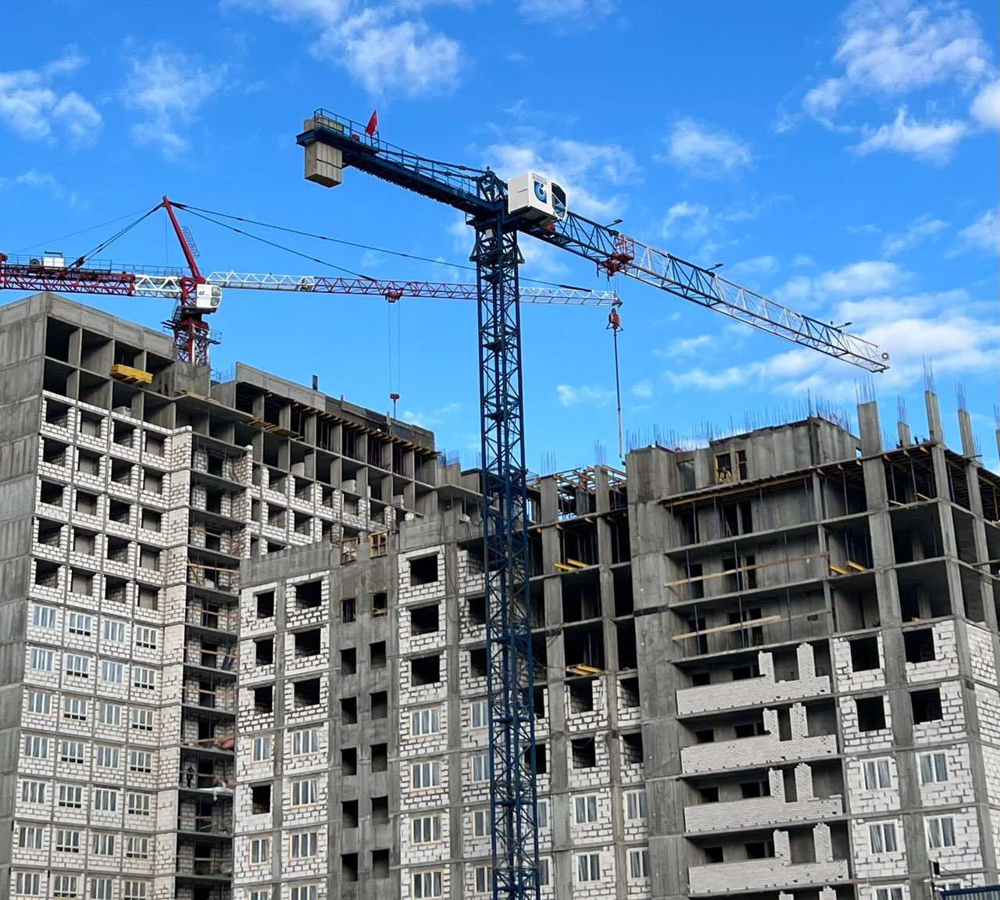

In [ ]:
Image(img_path)

In [ ]:
# With an image path
result = get_prediction(img_path, detection_model)

# With a numpy image
# result = get_prediction(read_image("/content/drive/MyDrive/urbancode/urbanhack-train/private/images/0000000111building.jpg"), detection_model)


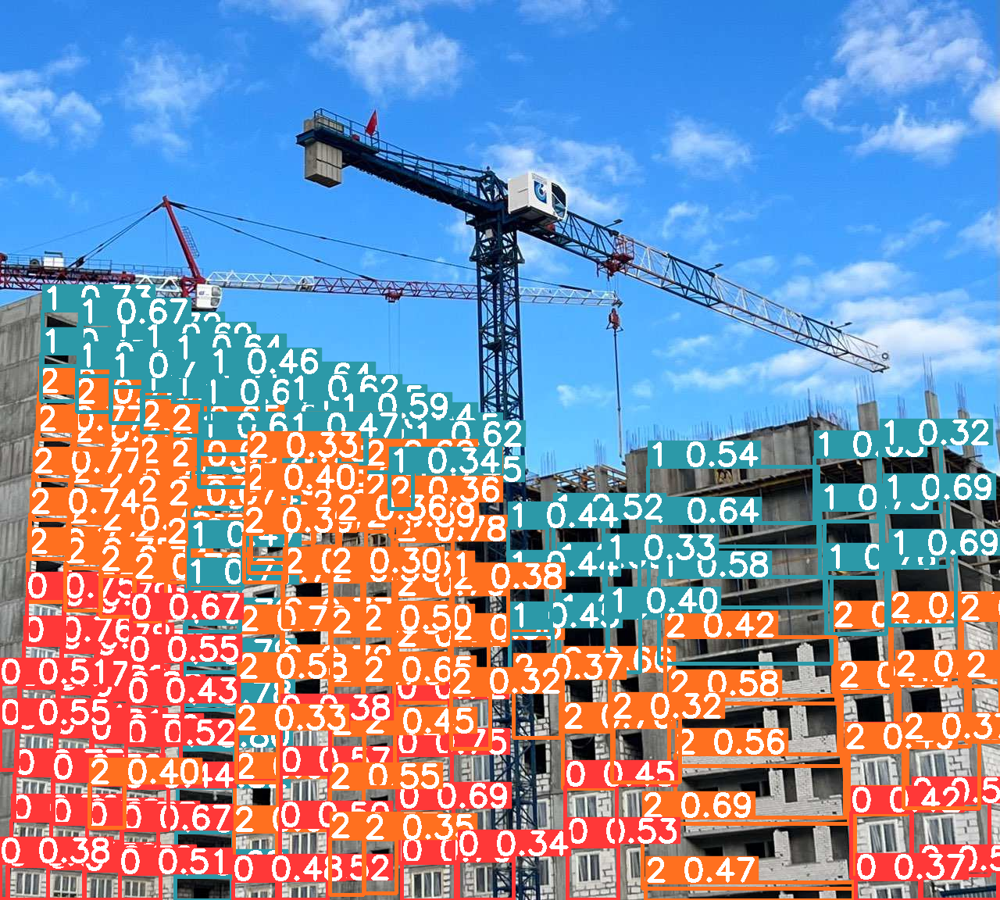

In [ ]:
result.export_visuals(export_dir="/content/drive/MyDrive/urbancode/urbanhack-train/sahi/sahi_export_data")
Image("/content/drive/MyDrive/urbancode/urbanhack-train/sahi/sahi_export_data/prediction_visual.png")

In [ ]:
object_prediction_list = result.object_prediction_list

In [ ]:
object_prediction_list

In [ ]:
result = get_sliced_prediction(
    img_path,
    detection_model,
    slice_height=100,
    slice_width=20,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2
)

Performing prediction on 1200 number of slices.


In [ ]:
get_sliced_prediction

<function sahi.predict.get_sliced_prediction(image, detection_model=None, slice_height: int = None, slice_width: int = None, overlap_height_ratio: float = 0.2, overlap_width_ratio: float = 0.2, perform_standard_pred: bool = True, postprocess_type: str = 'GREEDYNMM', postprocess_match_metric: str = 'IOS', postprocess_match_threshold: float = 0.5, postprocess_class_agnostic: bool = False, verbose: int = 1, merge_buffer_length: int = None, auto_slice_resolution: bool = True) -> sahi.prediction.PredictionResult>

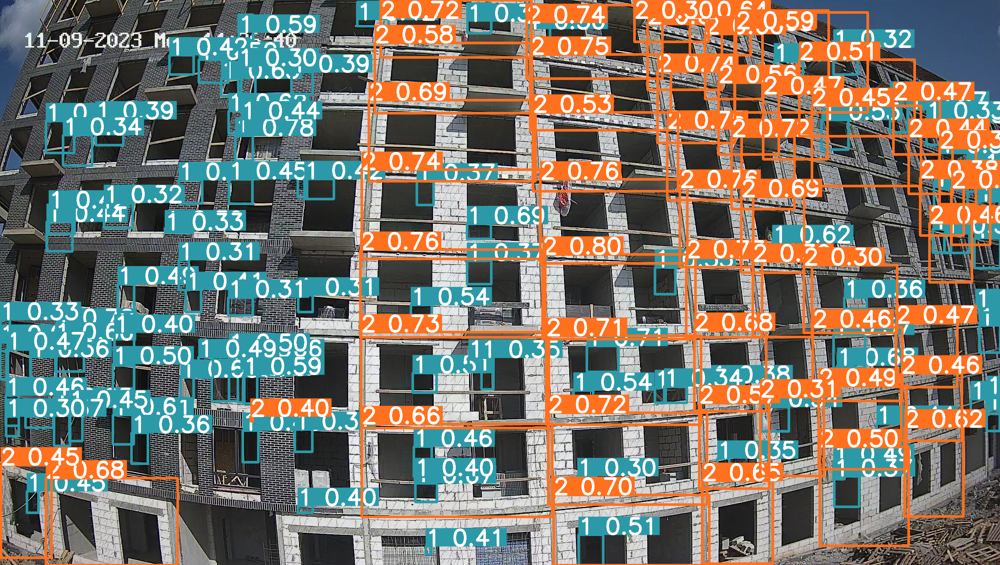

In [ ]:
result.export_visuals(export_dir="/content/drive/MyDrive/urbancode/urbanhack-train/sahi/sahi_export_data_sliced")

Image("/content/drive/MyDrive/urbancode/urbanhack-train/sahi/sahi_export_data_sliced/prediction_visual.png")

In [ ]:
# Access the object prediction list
object_prediction_list = result.object_prediction_list

In [ ]:
object_prediction_list

# add TTA for inference

https://github.com/obss/sahi/blob/main/docs/cli.md#predict-command-usage

https://docs.ultralytics.com/guides/sahi-tiled-inference/#installation

In [ ]:
!pip install -U ultralytics sahi


In [2]:
from sahi.utils.yolov8 import download_yolov8s_model
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from pathlib import Path
from IPython.display import Image

# Download YOLOv8 model
yolov8_model_path = "/content/drive/MyDrive/urbancode/urbanhack-train/yolov8m_best233.pt"
download_yolov8s_model(yolov8_model_path)

In [22]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_model_path,
    confidence_threshold=0.5,
    device="cpu",  # or 'cuda:0'
)


In [23]:
import cv2

In [24]:
image = cv2.imread("/content/straight.jpg")

In [25]:
# With an image path
result = get_prediction("/content/straight.jpg", detection_model)

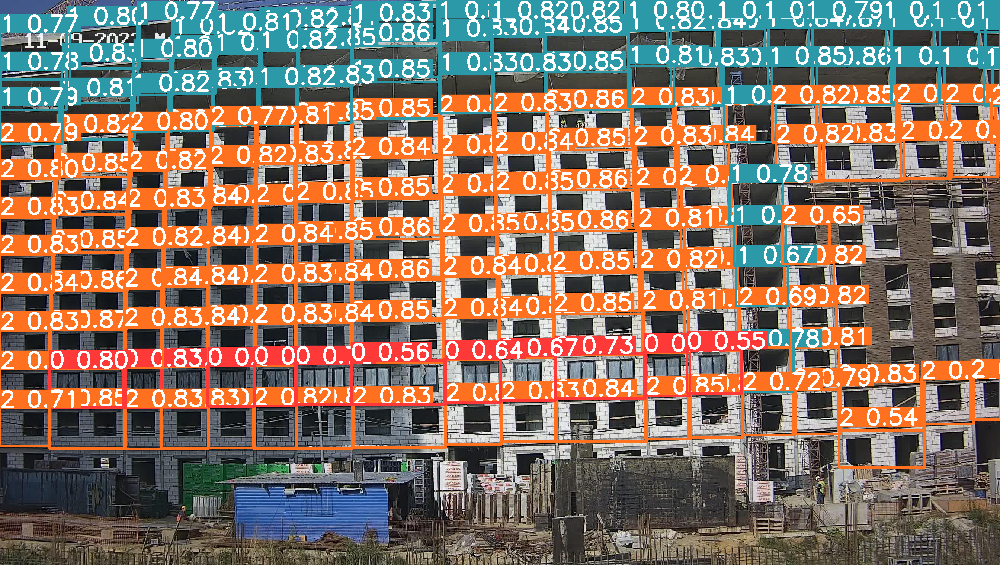

In [26]:
result.export_visuals(export_dir="demo_data/")
Image("demo_data/prediction_visual.png")


Perform sliced inference by specifying the slice dimensions and overlap ratios:



In [15]:
image.shape[0]/2

760.0

In [35]:
result = get_sliced_prediction(
    "/content/straight.jpg",
    detection_model,
    slice_height=int(image.shape[0]/2),
    slice_width=int(image.shape[1]/2),
    overlap_height_ratio=0,
    overlap_width_ratio=0,
    # perform_standard_pred = True,
    # postprocess_type = 'NMS'
)


Performing prediction on 4 number of slices.


In [29]:
get_sliced_prediction

<function sahi.predict.get_sliced_prediction(image, detection_model=None, slice_height: int = None, slice_width: int = None, overlap_height_ratio: float = 0.2, overlap_width_ratio: float = 0.2, perform_standard_pred: bool = True, postprocess_type: str = 'GREEDYNMM', postprocess_match_metric: str = 'IOS', postprocess_match_threshold: float = 0.5, postprocess_class_agnostic: bool = False, verbose: int = 1, merge_buffer_length: int = None, auto_slice_resolution: bool = True) -> sahi.prediction.PredictionResult>

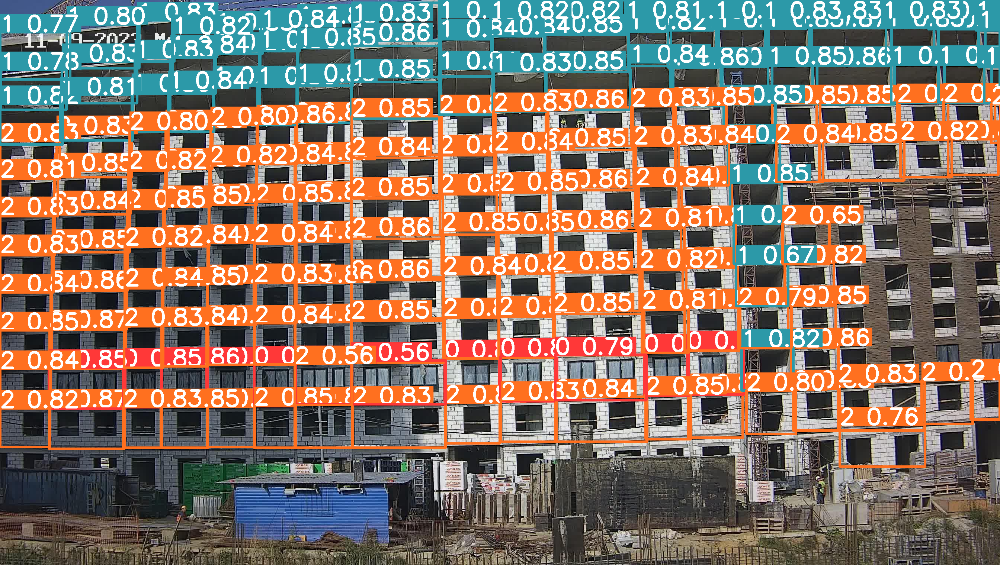

In [36]:
result.export_visuals(export_dir="demo_data/")
Image("demo_data/prediction_visual.png")

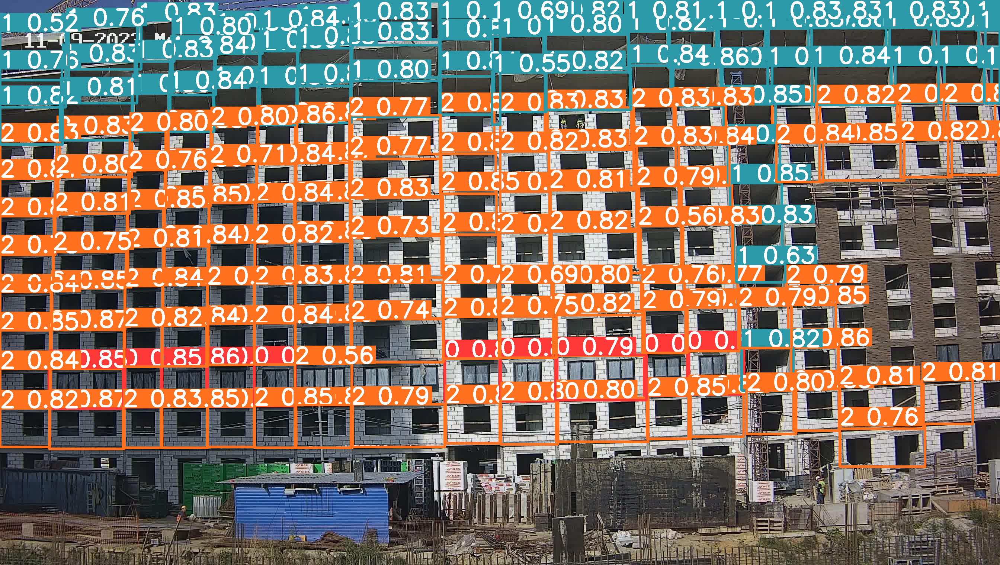

In [34]:
result.export_visuals(export_dir="demo_data/")
Image("demo_data/prediction_visual.png")


In [37]:
predict

<function sahi.predict.predict(detection_model: sahi.models.base.DetectionModel = None, model_type: str = 'mmdet', model_path: str = None, model_config_path: str = None, model_confidence_threshold: float = 0.25, model_device: str = None, model_category_mapping: dict = None, model_category_remapping: dict = None, source: str = None, no_standard_prediction: bool = False, no_sliced_prediction: bool = False, image_size: int = None, slice_height: int = 512, slice_width: int = 512, overlap_height_ratio: float = 0.2, overlap_width_ratio: float = 0.2, postprocess_type: str = 'GREEDYNMM', postprocess_match_metric: str = 'IOS', postprocess_match_threshold: float = 0.5, postprocess_class_agnostic: bool = False, novisual: bool = False, view_video: bool = False, frame_skip_interval: int = 0, export_pickle: bool = False, export_crop: bool = False, dataset_json_path: bool = None, project: str = 'runs/predict', name: str = 'exp', visual_bbox_thickness: int = None, visual_text_size: float = None, visua